# 01-patient-similarity-networks.ipynb

Code accompanying the presentation: "Computational and personalized medicine with a view to network science, machine learning and biophysical modelling" at the XXIII Polish Conference on Biocybernetics and Biomedical Engineering (PCBBE), Lodz University of Technology, 27-29 September 2023

Arvid Lundervold, 20230924   - **WORK IN PROGRESS**

using conda kernel pcbbe-2023 (Python 3.9.13)



Make an example of a patient similarity network with simulated data from 150 patients, and 6 features (both nominal, ordinal, and numeric)  from each patient an 3 latent patient groups

In [25]:
# pip install numpy pandas networkx matplotlib gower

Here's a Python code snippet to generate the simulated data and create a patient similarity network:

We will be using the `gower` similarity measure. Refs:
```
@article{gower1971,
  title={A General Coefficient of Similarity and Some of Its Properties},
  author={Gower, J. C.},
  journal={Biometrics},
  volume={27},
  number={4},
  pages={857--871},
  year={1971},
  url={https://www.jstor.org/stable/2528823}
}

@article{podani2002,
  title={Resemblance Coefficients and the Horseshoe Effect in Principal Coordinates Analysis},
  author={Podani, J. and Miklós, I.},
  journal={Ecology},
  volume={83},
  number={12},
  pages={3331--3343},
  year={2002},
  url={https://link.springer.com/article/10.1023/A:1021254903901}
}
```

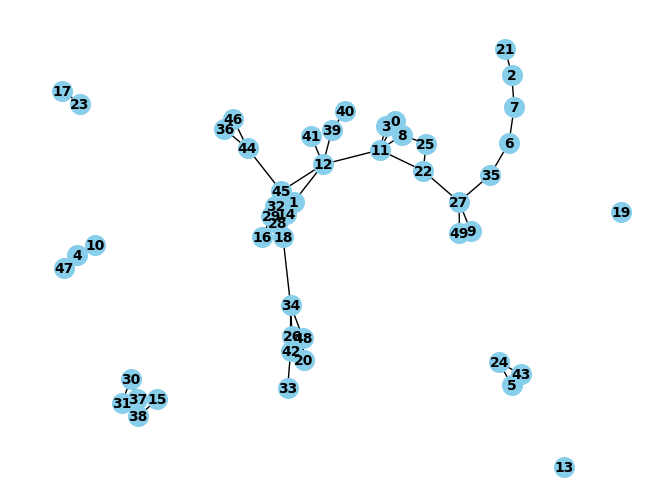

In [26]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 50

# Generate nominal feature: Blood Type
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)

# Generate ordinal feature: Pain Level
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)

# Generate numeric features: Age, Weight, Height
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)

# Generate continuous feature: Blood Test Result
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Create an empty graph
G = nx.Graph()

# Add nodes
for i in range(num_patients):
    G.add_node(i)

# Add edges based on similarity
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > 0.75:  # Threshold for adding an edge
            G.add_edge(i, j, weight=sim)

# Draw the network
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color='skyblue', font_weight='bold', node_size=200, font_size=10)
plt.show()



In the python code above with 50 patients in a PSN, we will make code for community detection.

Community detection can be performed using various algorithms. One commonly used algorithm for this purpose is the Louvain method. Below is the updated Python code that includes community detection for a Patient Similarity Network (PSN) with 50 patients.

First, you'll need to install the required packages if you haven't already:

In [27]:
# !pip install numpy pandas networkx matplotlib gower python-louvain

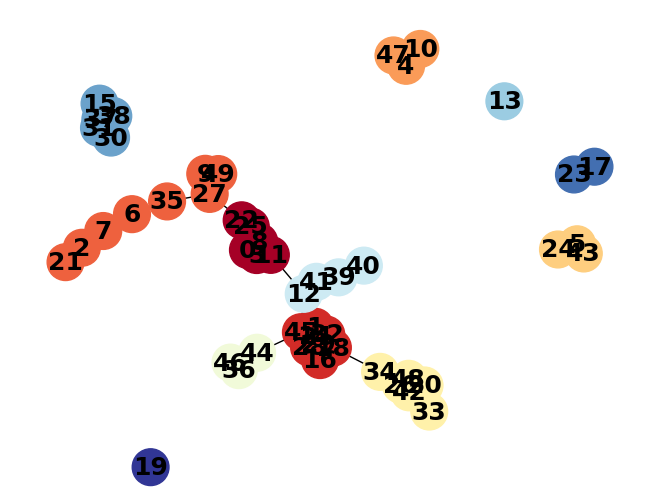

Community 1: 0, 3, 8, 11, 22, 25
Community 2: 1, 14, 16, 18, 28, 29, 32, 45
Community 3: 2, 6, 7, 9, 21, 27, 35, 49
Community 4: 4, 10, 47
Community 5: 5, 24, 43
Community 6: 20, 26, 33, 34, 42, 48
Community 7: 36, 44, 46
Community 8: 12, 39, 40, 41
Community 9: 13
Community 10: 15, 30, 31, 37, 38
Community 11: 17, 23
Community 12: 19


In [28]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 50

# Generate nominal feature: Blood Type
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)

# Generate ordinal feature: Pain Level
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)

# Generate numeric features: Age, Weight, Height
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)

# Generate continuous feature: Blood Test Result
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Create an empty graph
G = nx.Graph()

# Add nodes
for i in range(num_patients):
    G.add_node(i)

# Add edges based on similarity
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > 0.75:  # Threshold for adding an edge
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, font_weight='bold', node_size=700, font_size=18)
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


- _"You can adjust the threshold for adding an edge to fine-tune the network". How do I do this in a best way, or a way I can justify_

I'll implement two methods for choosing an edge threshold:

- **Statistical Analysis**: Specifically, I'll use the mean plus one standard deviation of the edge weights as a threshold.
- **Optimization Metrics**: I'll use modularity to evaluate the quality of the detected communities for different thresholds and choose the one that maximizes modularity.

Here's the updated Python code:

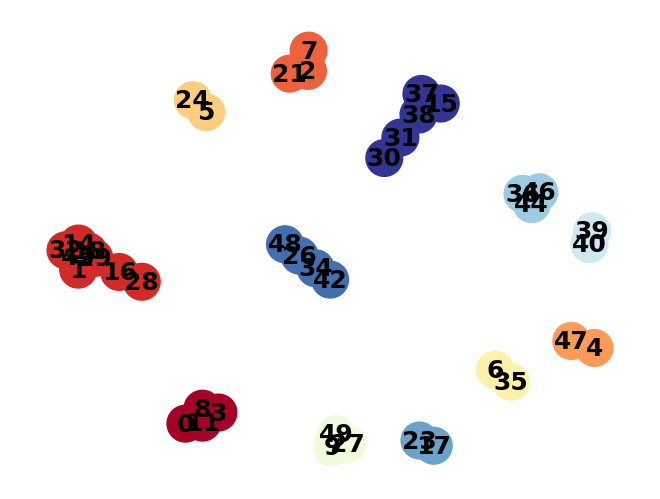

Community 1: 0, 8, 11, 3
Community 2: 1, 18, 45, 14, 29, 32, 16, 28
Community 3: 2, 7, 21
Community 4: 4, 47
Community 5: 5, 24
Community 6: 6, 35
Community 7: 9, 27, 49
Community 8: 39, 40
Community 9: 36, 44, 46
Community 10: 17, 23
Community 11: 26, 34, 48, 42
Community 12: 15, 38, 30, 31, 37


In [29]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 50

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Method 2: Optimization Metrics (Modularity)
best_modularity = -1
threshold_opt = 0

for t in np.linspace(mean_sim, mean_sim + 2*std_sim, 20):
    G_temp = nx.Graph()
    for i in range(num_patients):
        for j in range(i+1, num_patients):
            sim = gower_similarity[i, j]
            if sim > t:
                G_temp.add_edge(i, j, weight=sim)
    partition = community_louvain.best_partition(G_temp)
    modularity = community_louvain.modularity(partition, G_temp)
    if modularity > best_modularity:
        best_modularity = modularity
        threshold_opt = t

# Choose a threshold (here we use the one that maximizes modularity)
threshold = threshold_opt

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, font_weight='bold', node_size=700, font_size=18)
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


Below is the Python code that incorporates the Statistical Analysis method for choosing an edge threshold. Specifically, the threshold is set as the mean plus one standard deviation of the edge weights (similarities).

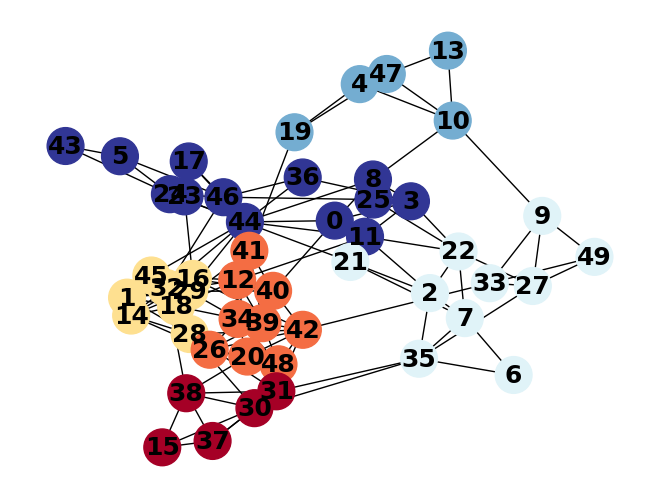

Community 1: 15, 30, 37, 38, 31
Community 2: 40, 12, 34, 39, 41, 26, 42, 20, 48
Community 3: 1, 14, 16, 18, 28, 29, 32, 45
Community 4: 2, 7, 21, 22, 35, 6, 9, 27, 33, 49
Community 5: 4, 10, 19, 47, 13
Community 6: 0, 3, 8, 11, 44, 36, 5, 24, 43, 46, 25, 23, 17


In [30]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 50

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, font_weight='bold', node_size=700, font_size=18)
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


- _ramp up the code to a PSN with 150 patients_

Below is the updated Python code for a Patient Similarity Network (PSN) with 150 patients. The edge threshold is determined using the Statistical Analysis method, specifically as the mean plus one standard deviation of the edge weights (similarities).

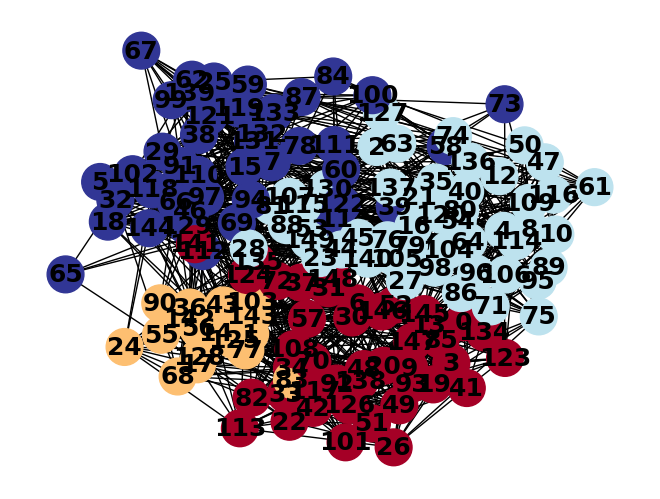

Community 1: 0, 3, 9, 13, 19, 20, 30, 31, 41, 48, 52, 85, 93, 123, 134, 138, 145, 146, 147, 148, 33, 34, 42, 101, 135, 72, 6, 26, 37, 49, 57, 126, 51, 82, 124, 22, 70, 92, 108, 117, 113, 141
Community 2: 1, 103, 14, 17, 36, 43, 55, 56, 68, 83, 90, 125, 142, 143, 77, 24, 128
Community 3: 4, 10, 109, 2, 21, 27, 40, 53, 54, 63, 74, 81, 104, 105, 107, 127, 130, 137, 64, 80, 8, 12, 35, 45, 47, 50, 61, 71, 75, 76, 79, 86, 95, 96, 98, 106, 114, 136, 140, 149, 88, 116, 23, 44, 120, 115, 16, 28, 89
Community 4: 39, 58, 91, 97, 110, 15, 38, 11, 5, 18, 29, 32, 46, 66, 69, 102, 111, 129, 144, 7, 132, 59, 60, 62, 67, 87, 99, 112, 119, 121, 122, 131, 133, 139, 100, 78, 84, 118, 65, 25, 94, 73


In [31]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 150  # Updated to 150 patients

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, font_weight='bold', node_size=700, font_size=18)
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


- _make the edges much thinner, and the node_size and font_size much smaller_

You can adjust the **linewidths** parameter for the edges and the **node_size** and **font_size** parameters for the nodes and labels. Here's the updated code with these adjustments:

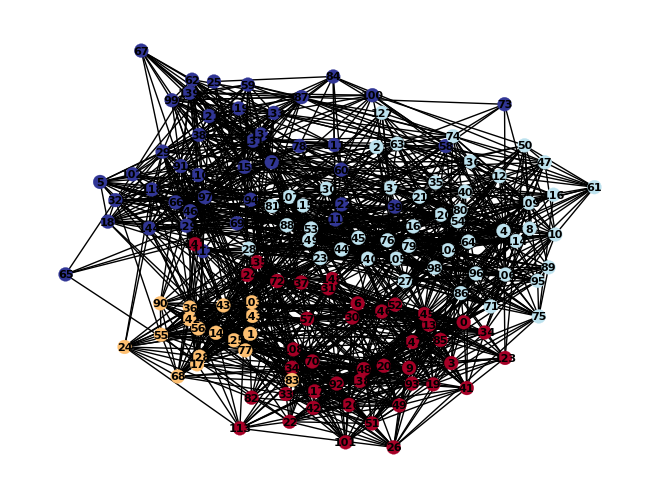

Community 1: 0, 3, 9, 13, 19, 20, 30, 31, 41, 48, 52, 85, 93, 123, 134, 138, 145, 146, 147, 148, 33, 34, 42, 101, 135, 72, 6, 26, 37, 49, 57, 126, 51, 82, 124, 22, 70, 92, 108, 117, 113, 141
Community 2: 1, 103, 14, 17, 36, 43, 55, 56, 68, 83, 90, 125, 142, 143, 77, 24, 128
Community 3: 4, 10, 109, 2, 21, 27, 40, 53, 54, 63, 74, 81, 104, 105, 107, 127, 130, 137, 64, 80, 8, 12, 35, 45, 47, 50, 61, 71, 75, 76, 79, 86, 95, 96, 98, 106, 114, 136, 140, 149, 88, 116, 23, 44, 120, 115, 16, 28, 89
Community 4: 39, 58, 91, 97, 110, 15, 38, 11, 5, 18, 29, 32, 46, 66, 69, 102, 111, 129, 144, 7, 132, 59, 60, 62, 67, 87, 99, 112, 119, 121, 122, 131, 133, 139, 100, 78, 84, 118, 65, 25, 94, 73


In [32]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 150  # Updated to 150 patients

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, font_weight='bold', node_size=100, font_size=8, linewidths=0.2)
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


- _Is it a better way to visualize the color-coded nodes (according to community)  and edges of this final graph?_

Visualizing large graphs can be challenging, especially when you want to highlight community structures. Here are some alternative approaches to improve the visualization:

- **Use a Different Layout Algorithm:** Force-directed layouts like Fruchterman-Reingold can sometimes provide clearer community structures.
- **Edge Transparency:** Use transparency to make edges less prominent, allowing nodes and communities to stand out.
- **Node Labeling:** Instead of labeling all nodes, you could label only a few representative nodes per community or avoid labels altogether for better clarity.
- **Legend for Communities:**  Add a legend to indicate which color corresponds to which community.

Here's the updated code incorporating these suggestions:

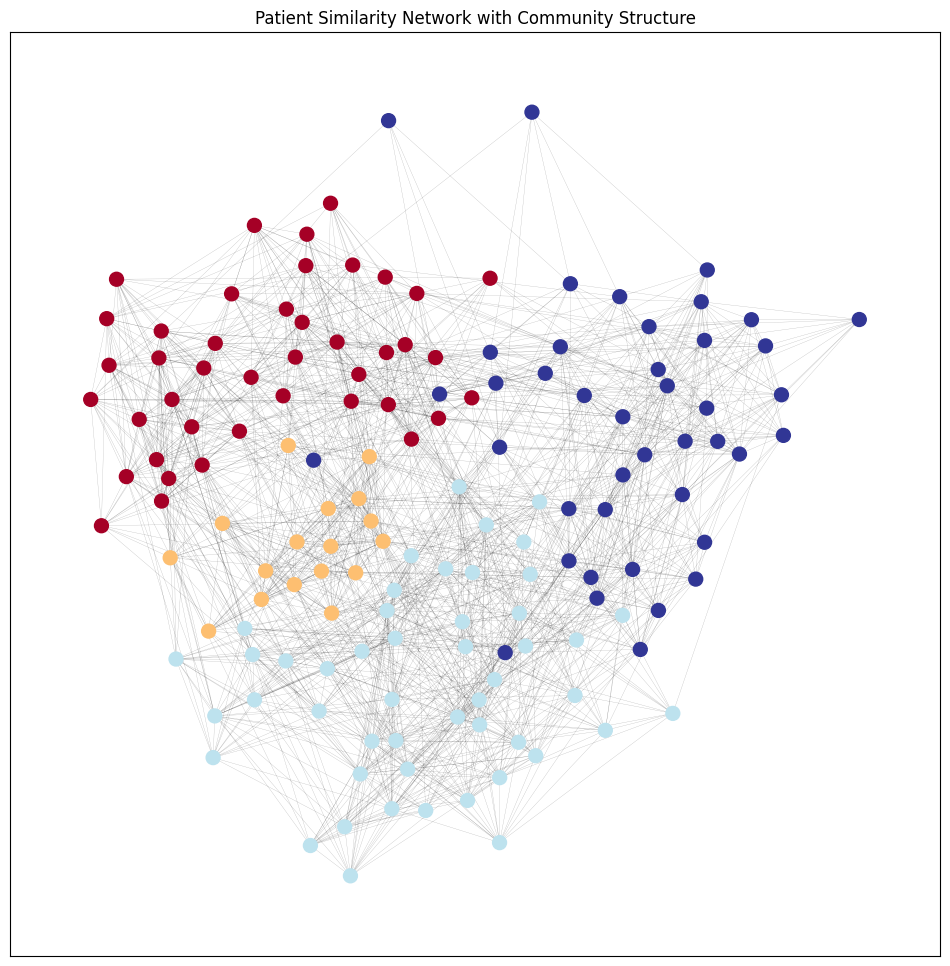

Community 1: 0, 3, 9, 13, 19, 20, 30, 31, 41, 48, 52, 85, 93, 123, 134, 138, 145, 146, 147, 148, 33, 34, 42, 101, 135, 72, 6, 26, 37, 49, 57, 126, 51, 82, 124, 22, 70, 92, 108, 117, 113, 141
Community 2: 1, 103, 14, 17, 36, 43, 55, 56, 68, 83, 90, 125, 142, 143, 77, 24, 128
Community 3: 4, 10, 109, 2, 21, 27, 40, 53, 54, 63, 74, 81, 104, 105, 107, 127, 130, 137, 64, 80, 8, 12, 35, 45, 47, 50, 61, 71, 75, 76, 79, 86, 95, 96, 98, 106, 114, 136, 140, 149, 88, 116, 23, 44, 120, 115, 16, 28, 89
Community 4: 39, 58, 91, 97, 110, 15, 38, 11, 5, 18, 29, 32, 46, 66, 69, 102, 111, 129, 144, 7, 132, 59, 60, 62, 67, 87, 99, 112, 119, 121, 122, 131, 133, 139, 100, 78, 84, 118, 65, 25, 94, 73


In [33]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 150

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Statistical Analysis for threshold
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, seed=42)  # Using Fruchterman-Reingold layout
nx.draw_networkx_edges(G, pos, alpha=0.3, width=0.2)
nx.draw_networkx_nodes(G, pos, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, node_size=100)
plt.title("Patient Similarity Network with Community Structure")
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


In this updated code, we have used the Fruchterman-Reingold layout (spring_layout), set edge transparency (alpha=0.3), and made edges thinner (width=0.2). I've also removed node labels for clarity and increased the figure size for better visibility. Feel free to adjust these parameters further to suit your needs.

- _Use this method to ramp up with a total of 500 patients in the PSN_

Scaling up to 500 patients will make the graph more complex, but the visualization techniques should help in making the communities more discernible. Here's the updated Python code for a Patient Similarity Network (PSN) with 500 patients:



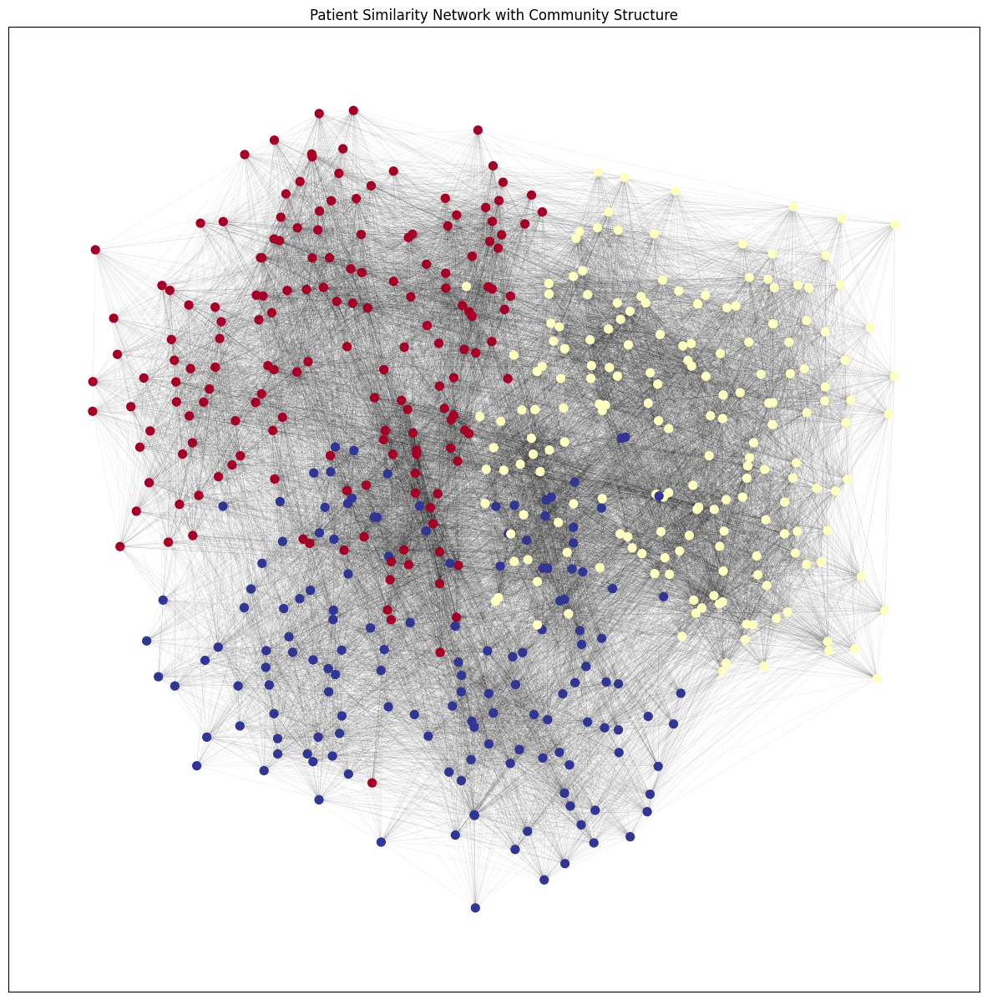

Community 1: 60, 61, 100, 134, 146, 176, 193, 213, 255, 368, 455, 28, 55, 83, 129, 142, 312, 405, 418, 435, 31, 38, 59, 62, 67, 74, 82, 209, 300, 330, 352, 470, 478, 498, 10, 138, 183, 187, 188, 386, 387, 423, 445, 459, 486, 8, 327, 81, 144, 149, 159, 471, 477, 6, 21, 22, 33, 35, 43, 57, 90, 105, 119, 131, 133, 139, 148, 185, 189, 203, 240, 254, 259, 266, 281, 286, 290, 304, 321, 336, 358, 361, 362, 363, 377, 388, 389, 397, 430, 431, 442, 457, 476, 480, 488, 491, 13, 48, 64, 88, 92, 101, 151, 156, 179, 269, 273, 311, 359, 364, 449, 49, 94, 195, 257, 307, 23, 44, 52, 65, 104, 225, 237, 270, 313, 402, 448, 481, 11, 106, 125, 170, 186, 451, 460, 475, 479, 16, 115, 143, 275, 279, 329, 411, 437, 450, 493, 14, 18, 76, 122, 130, 175, 303, 347, 353, 380, 381, 395, 452, 222, 296, 227, 277, 282, 343
Community 2: 54, 80, 153, 177, 194, 200, 214, 221, 268, 283, 314, 326, 391, 394, 438, 495, 1, 7, 24, 36, 63, 70, 72, 91, 97, 107, 110, 123, 126, 128, 140, 152, 157, 162, 163, 166, 172, 173, 201, 204,

In [34]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 500  # Updated to 500 patients

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

# Draw the network with community labels
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, seed=42)  # Using Fruchterman-Reingold layout
nx.draw_networkx_edges(G, pos, alpha=0.3, width=0.1)
nx.draw_networkx_nodes(G, pos, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, node_size=50)
plt.title("Patient Similarity Network with Community Structure")
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


In this updated code, we have increased the number of patients to 500. The rest of the code remains the same, including the method for determining the edge threshold and performing community detection. The visualization parameters have been adjusted to handle the larger graph. Feel free to further adjust these parameters to suit your needs.

- _Can you make a Pandas data frame of the underlying node data, and also an original adjacency matrix and an adjacency matrix after the thresholding_

You can create a Pandas DataFrame for the underlying node data using the original DataFrame df. For the adjacency matrices, you can create two: one for the original similarities (before thresholding) and another for the similarities after applying the threshold.

Here's how you can do it:

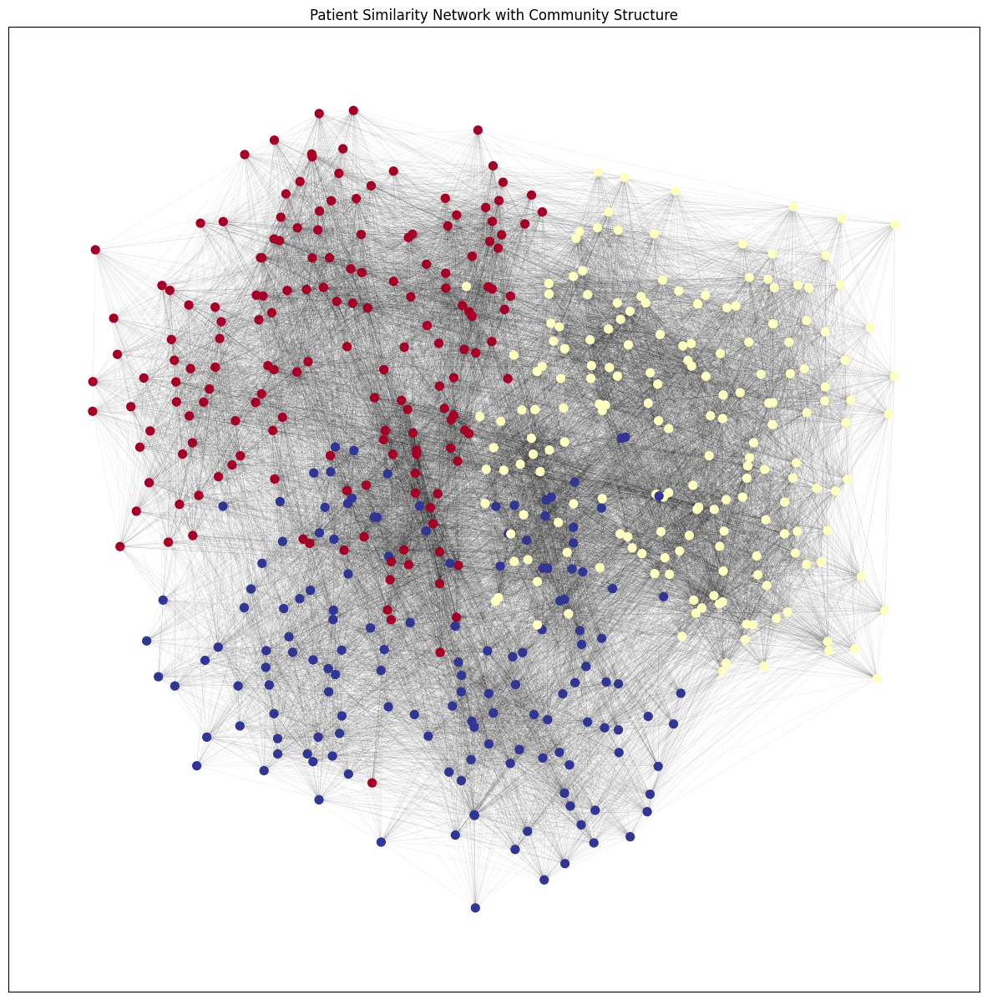

Community 1: 60, 61, 100, 134, 146, 176, 193, 213, 255, 368, 455, 28, 55, 83, 129, 142, 312, 405, 418, 435, 31, 38, 59, 62, 67, 74, 82, 209, 300, 330, 352, 470, 478, 498, 10, 138, 183, 187, 188, 386, 387, 423, 445, 459, 486, 8, 327, 81, 144, 149, 159, 471, 477, 6, 21, 22, 33, 35, 43, 57, 90, 105, 119, 131, 133, 139, 148, 185, 189, 203, 240, 254, 259, 266, 281, 286, 290, 304, 321, 336, 358, 361, 362, 363, 377, 388, 389, 397, 430, 431, 442, 457, 476, 480, 488, 491, 13, 48, 64, 88, 92, 101, 151, 156, 179, 269, 273, 311, 359, 364, 449, 49, 94, 195, 257, 307, 23, 44, 52, 65, 104, 225, 237, 270, 313, 402, 448, 481, 11, 106, 125, 170, 186, 451, 460, 475, 479, 16, 115, 143, 275, 279, 329, 411, 437, 450, 493, 14, 18, 76, 122, 130, 175, 303, 347, 353, 380, 381, 395, 452, 222, 296, 227, 277, 282, 343
Community 2: 54, 80, 153, 177, 194, 200, 214, 221, 268, 283, 314, 326, 391, 394, 438, 495, 1, 7, 24, 36, 63, 70, 72, 91, 97, 107, 110, 123, 126, 128, 140, 152, 157, 162, 163, 166, 172, 173, 201, 204,

In [35]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import gower
import community as community_louvain

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 500

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame for underlying node data
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Calculate Gower distance matrix
gower_distances = gower.gower_matrix(df)

# Convert Gower distance to similarity
gower_similarity = 1 - gower_distances

# Create original adjacency matrix (before thresholding)
adj_matrix_original = pd.DataFrame(gower_similarity)

# Method 1: Statistical Analysis
mean_sim = np.mean(gower_similarity)
std_sim = np.std(gower_similarity)
threshold_stat = mean_sim + std_sim

# Create an empty graph
G = nx.Graph()

# Add nodes and edges based on the chosen threshold
adj_matrix_thresholded = np.zeros((num_patients, num_patients))  # Initialize thresholded adjacency matrix
for i in range(num_patients):
    for j in range(i+1, num_patients):
        sim = gower_similarity[i, j]
        if sim > threshold_stat:
            G.add_edge(i, j, weight=sim)
            adj_matrix_thresholded[i, j] = sim  # Update thresholded adjacency matrix
            adj_matrix_thresholded[j, i] = sim  # Symmetric

# Convert to DataFrame
adj_matrix_thresholded = pd.DataFrame(adj_matrix_thresholded)

# Community detection using Louvain method
partition = community_louvain.best_partition(G)

y = partition
y_kyes = partition.keys()
y_values = partition.values()

# Draw the network with community labels
plt.figure(figsize=(15, 15))
pos = nx.spring_layout(G, seed=42)
nx.draw_networkx_edges(G, pos, alpha=0.3, width=0.1)
nx.draw_networkx_nodes(G, pos, node_color=list(partition.values()), cmap=plt.cm.RdYlBu, node_size=50)
plt.title("Patient Similarity Network with Community Structure")
plt.show()

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")

# Show DataFrames
print("Underlying Node Data:")
print(df.head())

print("Original Adjacency Matrix:")
print(adj_matrix_original.head())

print("Thresholded Adjacency Matrix:")
print(adj_matrix_thresholded.head())


In [36]:
df

,Blood_Type,Pain_Level,Age,Weight,Height,Blood_Test_Result
0,AB,High,27,95.637473,1.826632,48.601550
1,O,Low,34,62.411322,1.666157,92.029718
2,A,Low,77,78.881598,1.771239,52.076814
3,AB,High,37,58.275666,1.746638,61.649973
4,AB,Low,41,51.693958,1.540763,15.663844
...,...,...,...,...,...,...
495,AB,Low,44,93.591639,1.947907,72.139345
496,AB,Low,34,71.682767,1.661108,86.288050
497,O,Low,60,52.183083,1.562617,0.210384
498,A,Medium,76,58.083627,1.737168,71.757212


In [37]:
adj_matrix_original

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,0.410639,0.451991,0.799859,0.498269,0.603778,0.444890,0.491814,0.461514,0.645302,...,0.634795,0.511783,0.584997,0.456942,0.633157,0.700835,0.616146,0.263643,0.340976,0.278726
1,0.410639,1.000000,0.560798,0.567056,0.609085,0.632093,0.378125,0.730653,0.405663,0.444312,...,0.630890,0.525410,0.502192,0.463915,0.508137,0.574797,0.791110,0.707792,0.481646,0.837756
2,0.451991,0.560798,1.000000,0.466147,0.507776,0.371349,0.607146,0.771005,0.460268,0.375765,...,0.402366,0.611593,0.562246,0.457089,0.652450,0.602829,0.599638,0.541967,0.716942,0.574046
3,0.799859,0.567056,0.466147,1.000000,0.654780,0.657828,0.396225,0.594792,0.599814,0.678724,...,0.632861,0.507951,0.676206,0.501848,0.640206,0.611738,0.710698,0.420154,0.541117,0.478867
4,0.498269,0.609085,0.507776,0.654780,1.000000,0.496525,0.484291,0.613994,0.693568,0.413923,...,0.487130,0.407297,0.575828,0.344800,0.321523,0.621357,0.756110,0.747470,0.391695,0.659459
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,0.700835,0.574797,0.602829,0.611738,0.621357,0.318263,0.417440,0.577255,0.434064,0.422488,...,0.349281,0.455995,0.342494,0.588449,0.517745,1.000000,0.780303,0.402860,0.390953,0.496647
496,0.616146,0.791110,0.599638,0.710698,0.756110,0.463503,0.420348,0.717425,0.552688,0.421287,...,0.506446,0.567633,0.509504,0.502755,0.527778,0.780303,1.000000,0.521484,0.458622,0.651448
497,0.263643,0.707792,0.541967,0.420154,0.747470,0.632984,0.485420,0.546035,0.581699,0.345963,...,0.585837,0.339338,0.493228,0.292969,0.307326,0.402860,0.521484,1.000000,0.425886,0.853275
498,0.340976,0.481646,0.716942,0.541117,0.391695,0.371956,0.685622,0.642254,0.658028,0.386508,...,0.346989,0.741509,0.557000,0.614395,0.628753,0.390953,0.458622,0.425886,1.000000,0.523771


In [38]:
adj_matrix_thresholded

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,0.000000,0.000000,0.000000,0.799859,0.00000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.700835,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.730653,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.791110,0.707792,0.000000,0.837756
2,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.771005,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.716942,0.000000
3,0.799859,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.000000,0.000000,0.678724,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.710698,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.000000,0.693568,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.756110,0.747470,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,0.700835,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.780303,0.000000,0.000000,0.000000
496,0.000000,0.791110,0.000000,0.710698,0.75611,0.0,0.000000,0.717425,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.780303,0.000000,0.000000,0.000000,0.000000
497,0.000000,0.707792,0.000000,0.000000,0.74747,0.0,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.853275
498,0.000000,0.000000,0.716942,0.000000,0.00000,0.0,0.685622,0.000000,0.000000,0.000000,...,0.0,0.741509,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000


- _make head of df a latex table_

```
\begin{tabular}{lrrllrr}
\toprule
{} &  Age &  Weight & Blood\_Type & Pain\_Level &    Height &  Blood\_Test\_Result \\
\midrule
0 &   52 &   77.89 &          O &        Low &  1.89 &              43.27 \\
1 &   38 &   60.02 &          A &       High &  1.95 &              47.42 \\
2 &   68 &   89.76 &          B &     Medium &  1.76 &              10.99 \\
3 &   56 &   96.43 &         AB &        Low &  1.53 &              40.22 \\
4 &   45 &   55.19 &          O &       High &  1.66 &              14.81 \\
\bottomrule
\end{tabular}

```

- _make a heatmap

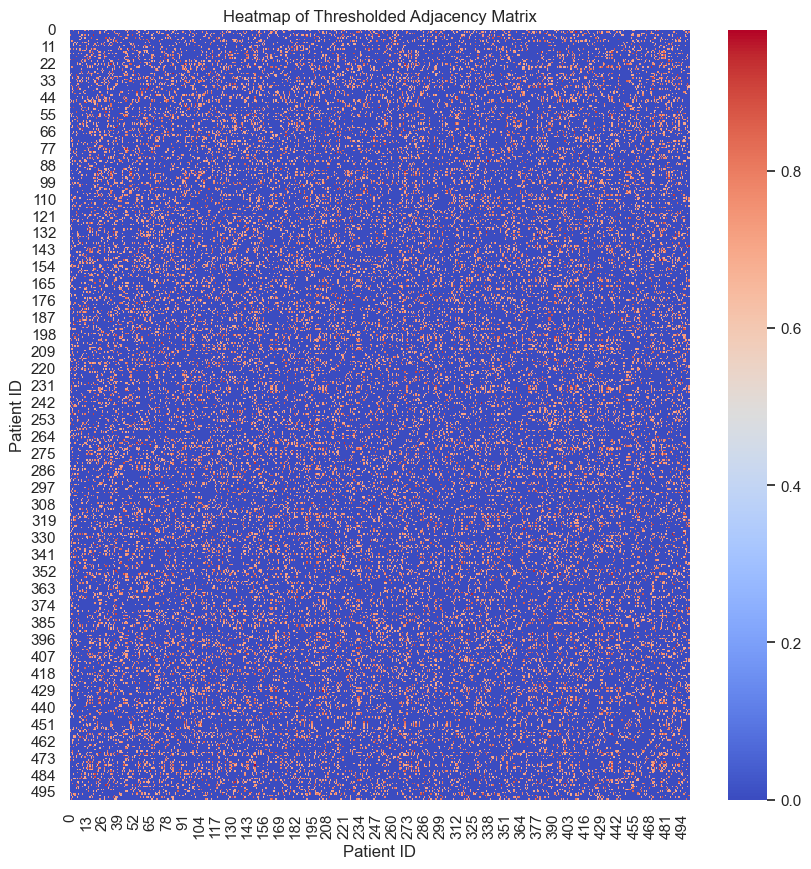

In [39]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming adj_matrix_thresholded is your DataFrame
sns.set()
plt.figure(figsize=(10, 10))
sns.heatmap(adj_matrix_thresholded, cmap='coolwarm', cbar=True)
plt.title('Heatmap of Thresholded Adjacency Matrix')
plt.xlabel('Patient ID')
plt.ylabel('Patient ID')
plt.show()

- _is it possible to visualize the network as interactive in 3D_

Yes, you can visualize the network in an interactive 3D environment using Python libraries like Plotly or py3dbp. These libraries allow you to create 3D network graphs that you can rotate, zoom, and hover over for more information.

Here's an example using Plotly to visualize the network in 3D:

In [40]:
import plotly.graph_objects as go

# Assuming G is your NetworkX graph and pos is the position dictionary
# You can use NetworkX to generate a 3D position layout
pos_3d = nx.spring_layout(G, dim=3, seed=42)

# Extract the positions
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Create a scatter plot for the nodes
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', marker=dict(size=6, color=list(partition.values()), colorscale='Viridis'))

# Create a line plot for the edges
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=0.5, color='grey'))

# Create the 3D network graph
fig = go.Figure(data=[edge_trace, node_trace])
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]),
                             yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]),
                             zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])),
                  margin=dict(l=0, r=0, b=0, t=0))

fig.show()

In this example, the nodes are color-coded based on their community, similar to the 2D visualization. The edges are drawn as lines between the nodes.

You can interact with the graph by clicking and dragging to rotate, scrolling to zoom, and hovering over nodes to see their attributes (if you add hover text to node_trace).

Add this code snippet after you've created your NetworkX graph G and the community partition to visualize it in 3D.

- _Could you add the node labels on the graph, and make i larger_

To add node labels and make the graph larger, you can modify the Plotly figure layout and add text annotations for the nodes. Here's the updated code

In [41]:
import plotly.graph_objects as go
import networkx as nx

# Assuming G is your NetworkX graph and pos is the position dictionary
# Generate a 3D position layout
pos_3d = nx.spring_layout(G, dim=3, seed=42)

# Extract the positions
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Create a scatter plot for the nodes
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers+text', 
                          marker=dict(size=10, color=list(partition.values()), colorscale='Viridis'),
                          text=list(pos_3d.keys()), textposition="top center")

# Create a line plot for the edges
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=0.5, color='grey'))

# Create the 3D network graph
fig = go.Figure(data=[edge_trace, node_trace])

# Update layout for a larger graph
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]),
                             yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]),
                             zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])),
                  margin=dict(l=0, r=0, b=0, t=0),
                  width=800, height=800)

fig.show()


In this updated code, I've added the text and textposition attributes to node_trace to include node labels. I've also increased the marker size to 10 for better visibility. The figure size is set to 800x800 pixels to make the graph larger.

You can interact with the graph by clicking and dragging to rotate, scrolling to zoom, and hovering over nodes to see their attributes. Add this code snippet after you've created your NetworkX graph G and the community partition to visualize it in 3D with labels.

- _instead of the x,y,z coordinates for each node, could I rather have the node values (cf. df) in the interactive plot?_

You can display the node attributes from the DataFrame df as hover text in the interactive 3D plot. To do this, you can create a list of strings that contain the attribute information for each node and then set this list as the hovertext attribute for the node_trace.

Here's the updated code:

In [42]:
import plotly.graph_objects as go
import networkx as nx

# Assuming G is your NetworkX graph and pos is the position dictionary
# Generate a 3D position layout
pos_3d = nx.spring_layout(G, dim=3, seed=42)

# Extract the positions
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Create hover text from DataFrame
hover_text = []
for i in range(len(df)):
    hover_text.append(f"Node {i}<br>" + "<br>".join([f"{col}: {df.loc[i, col]}" for col in df.columns]))

# Create a scatter plot for the nodes
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', 
                          marker=dict(size=10, color=list(partition.values()), colorscale='Viridis'),
                          hovertext=hover_text, hoverinfo="text")

# Create a line plot for the edges
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=0.5, color='grey'))

# Create the 3D network graph
fig = go.Figure(data=[edge_trace, node_trace])

# Update layout for a larger graph
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]),
                             yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]),
                             zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])),
                  margin=dict(l=0, r=0, b=0, t=0),
                  width=800, height=800)

fig.show()


In this updated code, we have created a list called hover_text that contains the attribute information for each node from the DataFrame df. This list is then set as the hovertext attribute for node_trace. Now, when you hover over a node in the interactive 3D plot, you'll see the attribute values for that node.

- _can you make the edges even more transparent_

To make the edges more transparent, you can adjust the opacity attribute of the line in edge_trace. Setting it to a value less than 1 will make the edges transparent. 

...
In this updated code, we have set the opacity attribute to 0.2 for the line in edge_trace. This will make the edges more transparent, allowing you to focus more on the nodes while still seeing the connections. Feel free to adjust the opacity value as needed.

In this updated code, I've set the line color to 'rgba(128, 128, 128, 0.2)', where the last value (0.2) is the alpha value that controls the opacity. Feel free to adjust this value to your liking.

In [43]:
import plotly.graph_objects as go
import networkx as nx

# Assuming G is your NetworkX graph and pos is the position dictionary
# Generate a 3D position layout
pos_3d = nx.spring_layout(G, dim=3, seed=42)

# Extract the positions
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Create hover text from DataFrame
hover_text = []
for i in range(len(df)):
    hover_text.append(f"Node {i}<br>" + "<br>".join([f"{col}: {df.loc[i, col]}" for col in df.columns]))

# Create a scatter plot for the nodes
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', 
                          marker=dict(size=10, color=list(partition.values()), colorscale='Viridis'),
                          hovertext=hover_text, hoverinfo="text")

# ... (previous code remains the same)

# Create a line plot for the edges with reduced opacity
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', 
                          line=dict(width=0.5, color='rgba(128, 128, 128, 0.2)'))  # Reduced opacity using RGBA

# ... (rest of the code remains the same)


# Create the 3D network graph
fig = go.Figure(data=[edge_trace, node_trace])

# Update layout for a larger graph
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]),
                             yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]),
                             zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])),
                  margin=dict(l=0, r=0, b=0, t=0),
                  width=800, height=800)

fig.show()


- _If we collect a new data point (patient), is it possible to make code that will perform a classification of this patient to one of the detected communities?_

To classify a new patient into one of the detected communities, you can use the following approach:

Calculate the similarity between the new patient and all existing patients in the network using the same Gower distance metric.
Identify the neighbors of the new patient based on a similarity threshold or a fixed number of nearest neighbors.
Majority vote: Assign the new patient to the community that most of its neighbors belong to.

In the following code snippet, the function classify_new_patient takes the new patient's data, the existing DataFrame df, the graph G, the community partition partition, and a similarity threshold threshold. It returns the community to which the new patient most likely belongs.

You can adjust the threshold or even use a fixed number of nearest neighbors based on your specific needs.

Here's a Python code snippet that demonstrates this:

In [44]:
from collections import Counter
import pandas as pd
import gower

def classify_new_patient(new_patient, df, G, partition, threshold):
    # Concatenate the new patient data with the existing DataFrame
    extended_df = pd.concat([df, new_patient.reset_index(drop=True)], ignore_index=True)
    
    # Calculate Gower distance between the new patient and existing patients
    gower_distances = gower.gower_matrix(extended_df)
    new_patient_distances = gower_distances[-1, :-1]
    
    # Convert Gower distance to similarity
    new_patient_similarity = 1 - new_patient_distances
    
    # Identify neighbors based on the threshold
    neighbors = [i for i, sim in enumerate(new_patient_similarity) if sim > threshold]
    
    # If no neighbors are above the threshold, take the top 5 most similar patients
    if len(neighbors) == 0:
        neighbors = new_patient_similarity.argsort()[-5:][::-1]
    
    # Majority vote to determine community
    neighbor_communities = [partition[i] for i in neighbors]
    most_common_community = Counter(neighbor_communities).most_common(1)[0][0]
    
    return most_common_community

# Create a new patient data point
new_patient = pd.DataFrame({
    'Blood_Type': ['A'],
    'Pain_Level': ['High'],
    'Age': [40],
    'Weight': [70.5],
    'Height': [1.75],
    'Blood_Test_Result': [45.0]
})

# Classify the new patient into one of the communities
# Assuming 'G' is your graph, 'df' is your DataFrame, and 'partition' is your community partition
threshold = 0.7  # You can adjust this value based on your specific needs
community = classify_new_patient(new_patient, df, G, partition, threshold)
print(f"The new patient belongs to community {community + 1}")


The new patient belongs to community 3


## Node classification

- _can you define and code the community classification by k-nearest neigbor_

To classify a new patient into one of the existing communities using k-nearest neighbors (k-NN), you can follow these steps:

Calculate the Gower distance between the new patient and all existing patients.
Identify the k-nearest neighbors based on the smallest Gower distances.
Use a majority vote to assign the new patient to the community that most of its k-nearest neighbors belong to.

Here's the Python code snippet that demonstrates this:

```python
from collections import Counter
import pandas as pd
import numpy as np
import gower

# Function to classify a new patient using k-NN
def classify_new_patient_knn(new_patient, df, G, partition, k):
    extended_df = pd.concat([df, new_patient.reset_index(drop=True)], ignore_index=True)
    gower_distances = gower.gower_matrix(extended_df)
    new_patient_distances = gower_distances[-1, :-1]
    
    # Identify k-nearest neighbors
    k_nearest_indices = np.argsort(new_patient_distances)[:k]
    
    # Majority vote to determine community
    neighbor_communities = [partition[i] for i in k_nearest_indices]
    most_common_community = Counter(neighbor_communities).most_common(1)[0][0]
    
    return most_common_community

# Create a new patient data point
new_patient = pd.DataFrame({
    'Blood_Type': ['A'],
    'Pain_Level': ['High'],
    'Age': [40],
    'Weight': [70.5],
    'Height': [1.75],
    'Blood_Test_Result': [45.0]
})

# Classify the new patient into one of the communities
# Assuming 'G' is your graph, 'df' is your DataFrame, and 'partition' is your community partition
k = 5  # Number of nearest neighbors
community = classify_new_patient_knn(new_patient, df, G, partition, k)
print(f"The new patient belongs to community {community + 1}")
```

In this code snippet, the function classify_new_patient_knn takes the new patient's data, the existing DataFrame df, the graph G, the community partition partition, and the number of nearest neighbors k. It returns the community to which the new patient most likely belongs.

You can adjust the value of k based on your specific needs and the size of your dataset.







In [45]:
from collections import Counter
import pandas as pd
import numpy as np
import gower

# Function to classify a new patient using k-NN
def classify_new_patient_knn(new_patient, df, G, partition, k):
    extended_df = pd.concat([df, new_patient.reset_index(drop=True)], ignore_index=True)
    gower_distances = gower.gower_matrix(extended_df)
    new_patient_distances = gower_distances[-1, :-1]
    
    # Identify k-nearest neighbors
    k_nearest_indices = np.argsort(new_patient_distances)[:k]
    
    # Majority vote to determine community
    neighbor_communities = [partition[i] for i in k_nearest_indices]
    most_common_community = Counter(neighbor_communities).most_common(1)[0][0]
    
    return most_common_community

# Create a new patient data point
new_patient = pd.DataFrame({
    'Blood_Type': ['A'],
    'Pain_Level': ['High'],
    'Age': [40],
    'Weight': [70.5],
    'Height': [1.75],
    'Blood_Test_Result': [45.0]
})

# Classify the new patient into one of the communities
# Assuming 'G' is your graph, 'df' is your DataFrame, and 'partition' is your community partition
k = 5  # Number of nearest neighbors
community = classify_new_patient_knn(new_patient, df, G, partition, k)
print(f"The new patient belongs to community {community + 1}")


The new patient belongs to community 3


- _Visualize the added patient and class belonging on the original graph - code?_

To visualize the new patient on the existing graph, you can add a new node to the NetworkX graph object G and then update the 3D Plotly visualization. The new patient node will be highlighted with a larger size and a different color to indicate its community.

Here's the full code snippet that includes adding the new patient to the graph and updating the visualization:

In [46]:
import networkx as nx
import pandas as pd
import plotly.graph_objects as go
from collections import Counter
import numpy as np
import gower
from community import community_louvain

# Function to classify a new patient using k-NN
def classify_new_patient_knn(new_patient, df, G, partition, k):
    extended_df = pd.concat([df, new_patient.reset_index(drop=True)], ignore_index=True)
    gower_distances = gower.gower_matrix(extended_df)
    new_patient_distances = gower_distances[-1, :-1]
    k_nearest_indices = np.argsort(new_patient_distances)[:k]
    neighbor_communities = [partition[i] for i in k_nearest_indices]
    most_common_community = Counter(neighbor_communities).most_common(1)[0][0]
    return most_common_community

# Create a new patient data point
new_patient = pd.DataFrame({
    'Blood_Type': ['A'],
    'Pain_Level': ['High'],
    'Age': [40],
    'Weight': [70.5],
    'Height': [1.75],
    'Blood_Test_Result': [45.0]
})

# Classify the new patient and add to graph and partition
k = 5  # Number of nearest neighbors
community = classify_new_patient_knn(new_patient, df, G, partition, k)
new_node_id = len(G.nodes)
G.add_node(new_node_id)
partition[new_node_id] = community

# Update 3D layout and node colors
pos_3d = nx.spring_layout(G, dim=3, seed=42)
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Update hover text to include the new patient
hover_text = ["Your hover text here" for _ in G.nodes()]
hover_text.append(f"New Patient Node {new_node_id}")

# Update edge coordinates
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

# Create Plotly traces and layout
edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=0.5, color='rgba(128, 128, 128, 0.2)'))
marker_size = [20 if i == new_node_id else 10 for i in G.nodes()]
marker_color = ['red' if i == new_node_id else partition[i] for i in G.nodes()]
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', marker=dict(size=marker_size, color=marker_color, colorscale='Viridis'), hovertext=hover_text, hoverinfo="text")
fig = go.Figure(data=[edge_trace, node_trace])
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]), yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]), zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])), margin=dict(l=0, r=0, b=0, t=0), width=800, height=800)

# Show the figure
fig.show()


In this full code example, I've included placeholders for your actual DataFrame, NetworkX graph, and community detection. Replace those parts with your actual data and methods. The new patient node will be displayed with a larger size and a red color to make it stand out in the 3D visualization.

In [47]:
# Create a new patient data point
new_patient = pd.DataFrame({
    'Blood_Type': ['A'],
    'Pain_Level': ['High'],
    'Age': [40],
    'Weight': [70.5],
    'Height': [1.75],
    'Blood_Test_Result': [45.0]
})

# Classify the new patient into one of the communities
# Assuming 'G' is your graph, 'df' is your DataFrame, and 'partition' is your community partition
k = 5  # Number of nearest neighbors
community = classify_new_patient_knn(new_patient, df, G, partition, k)
print(f"The new patient belongs to community {community + 1}")

The new patient belongs to community 3


### Can you think of other ways to improve the patient similarity network? 

(in markdown please)

Certainly! Here's a markdown-formatted list of ways to improve a Patient Similarity Network (PSN):

---

## Ways to Improve Patient Similarity Network

### Data Preprocessing:

1. **Feature Engineering**: Extract more meaningful features from the raw data. For example, BMI could be calculated from weight and height.
  
2. **Feature Selection**: Use techniques like Principal Component Analysis (PCA) or feature importance scores from tree-based models to retain only the most informative features.

3. **Normalization**: Different features may have different scales, which could bias the distance metrics. Normalizing the features can mitigate this.

---

### Similarity Measures:

1. **Multiple Distance Metrics**: Instead of just using Gower distance, you could experiment with other distance metrics like Cosine Similarity, Jaccard Index, or Mahalanobis distance and even combine them.

2. **Weighted Features**: If some features are more important than others in determining similarity, you can assign weights to them.

---

### Network Construction:

1. **Dynamic Thresholding**: Instead of using a single global threshold for edge creation, you could use a dynamic threshold based on the distribution of similarity scores.

2. **Edge Weighting**: Use the similarity score as a weight on the edges to capture the degree of similarity.

---

### Community Detection:

1. **Advanced Algorithms**: Use more advanced community detection algorithms like Infomap, Walktrap, or Spinglass.

2. **Multi-layer Networks**: If you have temporal data, multi-layer networks can be used for community detection.

---

### Visualization:

1. **Interactive Dashboards**: Use tools like Dash or Tableau to create interactive dashboards where clinicians can select features to be included in the similarity measure.

2. **Attribute Coloring**: Use color-coding to represent different attributes (e.g., disease stage, treatment response) on the nodes.

---

### Validation:

1. **Clinical Validation**: Correlate the communities or clusters found in the PSN with actual patient outcomes or other clinical markers.

2. **Bootstrap Resampling**: To assess the robustness of the communities detected.

---

### Scalability:

1. **Graph Databases**: For very large datasets, storing the PSN in a graph database like Neo4j could be more efficient for querying and analysis.

2. **Parallel Computing**: Use parallel algorithms for community detection and other graph analytics tasks to speed up computation.

---

### Interpretability:

1. **Node Embedding**: Use techniques like node2vec to embed the PSN into a lower-dimensional space and then use these embeddings for interpretability.

2. **Explainable AI**: Use explainable AI techniques to interpret the feature contributions to the similarity measure.

---

Improving a PSN is an iterative process and would likely involve a combination of these techniques, validated against clinical outcomes or expert opinion.

## What about using graph neural networks for this PSN task?

Using Graph Neural Networks (GNNs) for Patient Similarity Networks (PSNs) could be a highly effective approach, especially given your interest in neuroinformatics and computational medicine. GNNs are designed to work with graph-structured data and can capture complex relationships between nodes, which in this case are patients.

### Advantages of Using GNNs for PSNs:

1. **Feature Learning**: GNNs can automatically learn the most important features for community detection, eliminating the need for manual feature engineering.

2. **Non-linear Relationships**: GNNs can capture non-linear relationships between patients, which traditional methods might miss.

3. **Scalability**: GNNs can be scaled to handle large datasets, making them suitable for real-world healthcare applications.

4. **Interpretable Models**: Some GNN architectures are designed to be interpretable, which is crucial in healthcare applications for understanding why certain patients are grouped together.

### How to Implement:

1. **Data Preparation**: Convert your PSN into a format suitable for GNNs. Each node will represent a patient, and the node features will be the patient attributes. Edges can be weighted based on similarity measures like Gower distance.

2. **Model Architecture**: Choose a GNN architecture that suits your needs. Popular choices include Graph Convolutional Networks (GCNs), GraphSAGE, and GAT (Graph Attention Networks).

3. **Training**: Use the community labels as ground truth if available, and train the GNN to predict these labels. Alternatively, you can use unsupervised methods to learn a useful representation of the nodes.

4. **Evaluation**: Split your data into training, validation, and test sets to evaluate the performance of your GNN. Metrics could include accuracy for community detection, or silhouette score for clustering quality.

5. **Interpretation**: Use techniques like attention mechanisms or feature importance scores to interpret the model.

6. **Deployment**: Once trained, the GNN can be used to classify new patients into existing communities or to update the PSN as new data becomes available.

### Libraries and Tools:

- **PyTorch Geometric**: A PyTorch-based library for GNNs.
- **DGL (Deep Graph Library)**: Another popular library for GNNs, which supports both PyTorch and TensorFlow.
- **Spektral**: A TensorFlow library for GNNs.

### Example Code Snippet:

Here's a very simplified example using PyTorch Geometric to create a GCN for a PSN:

```python
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import Data

# Prepare your data as PyTorch Geometric Data object
# edge_index: Tensor containing edge indices
# x: Node features
# y: Labels (community IDs)
data = Data(x=torch.tensor(node_features, dtype=torch.float), edge_index=torch.tensor(edge_indices), y=torch.tensor(labels))

class GCN(torch.nn.Module):
    def __init__(self):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize and train your GCN model
model = GCN()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
```

This is a very basic example and the actual implementation would involve additional steps like data splitting, model evaluation, and so on.

Given the complexity and the potential for high impact in healthcare applications, this could be a very promising avenue for research and development.

In [ ]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import Data

# Prepare your data as PyTorch Geometric Data object
# edge_index: Tensor containing edge indices
# x: Node features
# y: Labels (community IDs)
data = Data(x=torch.tensor(node_features, dtype=torch.float), edge_index=torch.tensor(edge_indices), y=torch.tensor(labels))

class GCN(torch.nn.Module):
    def __init__(self):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize and train your GCN model
model = GCN()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

In [ ]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import Data

# Prepare your data as PyTorch Geometric Data object
# edge_index: Tensor containing edge indices
# x: Node features
# y: Labels (community IDs)

#node_features = df.to_numpy()
#node_features_tensor = torch.tensor(node_features, dtype=torch.float)

# -> TypeError: can't convert np.ndarray of type numpy.object_. 
# The only supported types are: float64, float32, float16, complex64, complex128, int64, int32, int16, int8, uint8, and bool.

# The error suggests that the DataFrame df contains non-numeric or mixed types, which cannot be directly converted to a PyTorch tensor. 
# You'll need to preprocess the DataFrame to ensure that all columns are of a numeric type that can be converted to a PyTorch tensor.

# Here's how you can handle this:

# Find columns of type 'object'
object_columns = df.select_dtypes(include=['object']).columns.tolist()

# Find columns of type 'category'
category_columns = df.select_dtypes(include=['category']).columns.tolist()

# Combine both lists to get all categorical columns
categorical_columns = object_columns + category_columns

print("Categorical columns:", categorical_columns)

df = pd.get_dummies(df, columns=categorical_columns) # One-hot encode categorical columns

df.fillna(0, inplace=True)  # Fills NaNs with 0

node_features = df.to_numpy()

node_features_tensor = torch.tensor(node_features, dtype=torch.float)


# Convert NetworkX graph edges to a PyTorch tensor
edge_list = list(G.edges())
source_nodes = [x[0] for x in edge_list]
target_nodes = [x[1] for x in edge_list]

# Combine source and target nodes

# new_tensor = existing_tensor.clone().detach()
new_tensor = node_features_tensor.clone().detach().requires_grad_(True)

edge_indices = torch.tensor([source_nodes, target_nodes], dtype=torch.long)


# Assuming edge_indices contains the edge information and labels contains the community IDs
# data = Data(x=new_tensor, edge_index=torch.tensor(edge_indices), y=torch.tensor(labels))
# data = Data(x=torch.tensor(node_features, dtype=torch.float), edge_index=torch.tensor(edge_indices), y=torch.tensor(labels))

# Assuming node_features_tensor contains the node features
# and edge_indices contains the edge information
data = Data(x=node_features_tensor, edge_index=edge_indices)

class GCN(torch.nn.Module):
    def __init__(self, num_node_features, num_classes):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(num_node_features, 16)
        self.conv2 = GCNConv(16, num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# When initializing the GCN model, you can now pass the number of node features and the number of classes 
# (if you have labels) as arguments:

# Number of node features and classes
num_node_features = data.num_node_features
num_classes = len(torch.unique(data.y)) if data.y is not None else None

# Initialize and train your GCN model
#model = GCN(num_node_features, num_classes)
#optimizer = torch.optim.Adam(model.parameters(), lr=0.01)


## All-in-one block

Here's a complete Python code block that includes all the steps for community detection in a Patient Similarity Network (PSN) with 500 patients, 6 features, Gower similarity, and statistical thresholding.

In [ ]:
# Import Libraries
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.data import Data
from sklearn.cluster import KMeans
import networkx as nx
import numpy as np
import pandas as pd
from gower import gower_matrix
from sklearn.preprocessing import LabelEncoder


# Simulated DataFrame with 500 patients and 6 features
# Replace this with your actual DataFrame
# df = pd.DataFrame(np.random.rand(500, 6), columns=['Feature1', 'Feature2', 'Feature3', 'Feature4', 'Feature5', 'Feature6'])

# or, more sophisticated:

# Seed for reproducibility
np.random.seed(42)

# Number of patients
num_patients = 500

# Generate features
blood_types = np.random.choice(['A', 'B', 'AB', 'O'], num_patients)
pain_levels = np.random.choice(['Low', 'Medium', 'High'], num_patients)
ages = np.random.randint(18, 81, num_patients)
weights = np.random.uniform(50, 100, num_patients)
heights = np.random.uniform(1.5, 2.0, num_patients)
blood_test_results = np.random.uniform(0, 100, num_patients)

# Create DataFrame
df = pd.DataFrame({
    'Blood_Type': blood_types,
    'Pain_Level': pain_levels,
    'Age': ages,
    'Weight': weights,
    'Height': heights,
    'Blood_Test_Result': blood_test_results
})

# Find columns of type 'object'
object_columns = df.select_dtypes(include=['object']).columns.tolist()

# Find columns of type 'category'
category_columns = df.select_dtypes(include=['category']).columns.tolist()

# Combine both lists to get all categorical columns
categorical_columns = object_columns + category_columns

print("Categorical columns:", categorical_columns)

print(df)

#df = pd.get_dummies(df, columns=categorical_columns) # One-hot encode categorical columns

# Alternatively: label encoding
labelencoder = LabelEncoder()
for col in categorical_columns:
    if col in ['Pain_Level']:
        ordinal_mapping = {'Low': 1, 'Medium': 2, 'High': 3}
        df[col] = df[col].map(ordinal_mapping)
    else:
        df[col] = labelencoder.fit_transform(df[col])

df.fillna(0, inplace=True)  # Fills NaNs with 0

# Number of features
num_features = df.shape[1]
print(f"Number of features: {num_features}")

# Generate Gower similarity matrix
gower_sim_matrix = gower_matrix(df)

# Create a NetworkX graph from the similarity matrix
# G = nx.Graph()
# for i in range(gower_sim_matrix.shape[0]):
#     for j in range(i+1, gower_sim_matrix.shape[1]):
#         G.add_edge(i, j, weight=gower_sim_matrix[i, j])

# Apply statistical thresholding (example: keep edges with weight > 0.7)
# threshold = 0.7
# G_thresholded = nx.Graph([(u, v, d) for u, v, d in G.edges(data=True) if d['weight'] > threshold])

# Create a NetworkX graph
G = nx.Graph()

# Add nodes
for i in range(len(df)):
    G.add_node(i)

# Add edges based on statistical thresholding
threshold = np.mean(gower_sim_matrix) + 2 * np.std(gower_sim_matrix)
for i in range(len(df)):
    for j in range(i+1, len(df)):
        if gower_sim_matrix[i][j] < threshold:
            G.add_edge(i, j, weight=gower_sim_matrix[i][j])


# Convert to PyTorch Geometric Data
# edge_indices = torch.tensor(list(G_thresholded.edges())).t().contiguous()
edge_indices = torch.tensor(list(G.edges())).t().contiguous()
node_features_tensor = torch.tensor(df.to_numpy(), dtype=torch.float)
data = Data(x=node_features_tensor, edge_index=edge_indices)

# Define GCN Model
class GCN(torch.nn.Module):
    def __init__(self, num_features, num_hidden):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(num_features, num_hidden)
        self.conv2 = GCNConv(num_hidden, num_hidden)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return x

# Initialize model and optimizer
num_features = data.num_node_features  # Should be 6, based on your dataset
num_hidden = 16  # This is an arbitrary number; you can adjust it

# Make sure the data has the correct number of features
assert data.x.size(1) == num_features, f"Data feature size {data.x.size(1)} does not match expected {num_features}"

model = GCN(num_features, num_hidden)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Training loop to learn embeddings (unsupervised)
for epoch in range(200):
    model.train()
    optimizer.zero_grad()
    out = model(data)
    # No loss function here, as we're learning embeddings for unsupervised tasks
    # Implement any regularization if needed
    optimizer.step()

# Community Detection using k-means
model.eval()
node_embeddings = model(data).detach().numpy()

# Apply k-means clustering on node embeddings
kmeans = KMeans(n_clusters=3)  # Assuming 3 communities
labels = kmeans.fit_predict(node_embeddings)

# Convert Labels to PyTorch Tensor
labels_tensor = torch.tensor(labels, dtype=torch.long)

# labels_tensor now contains the community IDs for each patient

# Convert labels to a dictionary
partition = {i: label.item() for i, label in enumerate(labels)}

print(df)

# Print communities
for i, comm in enumerate(set(partition.values())):
    print(f"Community {i+1}: {', '.join([str(node) for node, p in partition.items() if p == comm])}")


In [ ]:
labels_tensor

In [ ]:
import plotly.graph_objects as go
import networkx as nx

# Assuming G is your NetworkX graph and pos is the position dictionary
# Generate a 3D position layout
# pos_3d = nx.spring_layout(G_thresholded, dim=3, seed=42)
pos_3d = nx.spring_layout(G, dim=3, seed=42)

# Extract the positions
x_vals = [pos[0] for pos in pos_3d.values()]
y_vals = [pos[1] for pos in pos_3d.values()]
z_vals = [pos[2] for pos in pos_3d.values()]

# Create hover text from DataFrame
hover_text = []
for i in range(len(df)):
    hover_text.append(f"Node {i}<br>" + "<br>".join([f"{col}: {df.loc[i, col]}" for col in df.columns]))

# Create a scatter plot for the nodes
node_trace = go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', 
                          marker=dict(size=10, color=list(partition.values()), colorscale='Viridis'),
                          hovertext=hover_text, hoverinfo="text")

# ... (previous code remains the same)

# Create a line plot for the edges with reduced opacity
edge_x = []
edge_y = []
edge_z = []
for edge in G.edges():
    x0, y0, z0 = pos_3d[edge[0]]
    x1, y1, z1 = pos_3d[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', 
                          line=dict(width=0.5, color='rgba(128, 128, 128, 0.2)'))  # Reduced opacity using RGBA

# ... (rest of the code remains the same)


# Create the 3D network graph
fig = go.Figure(data=[edge_trace, node_trace])

# Update layout for a larger graph
fig.update_layout(scene=dict(xaxis=dict(nticks=4, range=[min(x_vals), max(x_vals)]),
                             yaxis=dict(nticks=4, range=[min(y_vals), max(y_vals)]),
                             zaxis=dict(nticks=4, range=[min(z_vals), max(z_vals)])),
                  margin=dict(l=0, r=0, b=0, t=0),
                  width=800, height=800)

fig.show()